## 1. data loading

In [85]:
import pandas as pd
diamonds = pd.read_csv('../data/diamonds_train.csv')

diamonds

,carat,cut,color,clarity,depth,table,price,x,y,z
0,1.21,Premium,J,VS2,62.4,58.0,4268,6.83,6.79,4.25
1,0.32,Very Good,H,VS2,63.0,57.0,505,4.35,4.38,2.75
2,0.71,Fair,G,VS1,65.5,55.0,2686,5.62,5.53,3.65
3,0.41,Good,D,SI1,63.8,56.0,738,4.68,4.72,3.00
4,1.02,Ideal,G,SI1,60.5,59.0,4882,6.55,6.51,3.95
...,...,...,...,...,...,...,...,...,...,...
40450,1.34,Ideal,G,VS1,62.7,57.0,10070,7.10,7.04,4.43
40451,2.02,Good,F,SI2,57.1,60.0,12615,8.31,8.25,4.73
40452,1.01,Ideal,H,SI1,62.7,56.0,5457,6.37,6.42,4.01
40453,0.33,Ideal,J,VS1,61.9,54.3,456,4.45,4.47,2.76


### info Diamonds:
#### Vocabulary in Spanish:
- carat: 'quilates' (1 quilate = 0.2g)
- cut: 'talla'
- color: 'color'
- clarity: 'pureza'


##### depth and table, are percentage about "x" for to know the type of cut
##### "x" "y" "z" are dimensions of the rough diamond


## 2.Get data info

### get data info about the DF (Diamonds)

In [5]:
diamonds.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 40455 entries, 0 to 40454
Data columns (total 10 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   carat    40455 non-null  float64
 1   cut      40455 non-null  object 
 2   color    40455 non-null  object 
 3   clarity  40455 non-null  object 
 4   depth    40455 non-null  float64
 5   table    40455 non-null  float64
 6   price    40455 non-null  int64  
 7   x        40455 non-null  float64
 8   y        40455 non-null  float64
 9   z        40455 non-null  float64
dtypes: float64(6), int64(1), object(3)
memory usage: 3.1+ MB


### get data types

In [2]:
diamonds.dtypes

carat      float64
cut         object
color       object
clarity     object
depth      float64
table      float64
price        int64
x          float64
y          float64
z          float64
dtype: object

### get summary statistics of Diamonds

In [19]:
diamonds.describe(include='all')

,carat,cut,color,clarity,depth,table,price,x,y,z
count,40455.000000,40455,40455,40455,40455.000000,40455.000000,40455.000000,40455.000000,40455.000000,40455.000000
unique,NaN,5,7,8,NaN,NaN,NaN,NaN,NaN,NaN
top,NaN,Ideal,G,SI1,NaN,NaN,NaN,NaN,NaN,NaN
freq,NaN,16220,8455,9749,NaN,NaN,NaN,NaN,NaN,NaN
mean,0.797706,NaN,NaN,NaN,61.752841,57.446133,3928.444469,5.729392,5.732819,3.537154
std,0.475544,NaN,NaN,NaN,1.431725,2.233535,3992.416147,1.124453,1.146650,0.697062
min,0.200000,NaN,NaN,NaN,43.000000,43.000000,326.000000,0.000000,0.000000,0.000000
25%,0.400000,NaN,NaN,NaN,61.000000,56.000000,945.000000,4.710000,4.720000,2.910000
50%,0.700000,NaN,NaN,NaN,61.800000,57.000000,2397.000000,5.690000,5.710000,3.520000
75%,1.040000,NaN,NaN,NaN,62.500000,59.000000,5331.000000,6.540000,6.540000,4.035000


#### Types of 'cut':

In [21]:
diamonds['cut'].unique()

array(['Premium', 'Very Good', 'Fair', 'Good', 'Ideal'], dtype=object)

##### The list sorted (AGS/GIA) is: Ideal, Premium, Very Good , Good , Fair 

#### Types of 'color':

In [22]:
diamonds['color'].unique()

array(['J', 'H', 'G', 'D', 'F', 'E', 'I'], dtype=object)

##### The list sorted (AGS/GIA) is: D, E, F, G, H, I, J

#### Types of 'clarity':

In [11]:
diamonds['clarity'].unique()

array(['VS2', 'VS1', 'SI1', 'SI2', 'IF', 'VVS1', 'VVS2', 'I1'],
      dtype=object)

##### The list sorted (AGS/GIA) is: IF, VVS1, VVS2, VS1, VS2, SI1, SI2, I1

#### Correlation between numerical columns:

In [8]:
diamonds.corr()

,carat,depth,table,price,x,y,z
carat,1.000000,0.026528,0.183392,0.921935,0.975688,0.951667,0.967570
depth,0.026528,1.000000,-0.293114,-0.014864,-0.026348,-0.030966,0.094655
table,0.183392,-0.293114,1.000000,0.130111,0.196059,0.184673,0.155189
price,0.921935,-0.014864,0.130111,1.000000,0.885848,0.866163,0.874500
x,0.975688,-0.026348,0.196059,0.885848,1.000000,0.973712,0.984876
y,0.951667,-0.030966,0.184673,0.866163,0.973712,1.000000,0.964828
z,0.967570,0.094655,0.155189,0.874500,0.984876,0.964828,1.000000


##### We can observe that the highest correlation appears between the "carat" column and the "x", "y" and "z" columns. This means that the larger the diamond, the greater its weight.
##### Another important point is that the higher the "carat", the higher the price


## 3. visualizing summary statistics

### Import libraries

In [87]:
import matplotlib.pyplot as plt
import cufflinks as cf
import plotly.express as px

In [88]:
%matplotlib inline

In [89]:
cf.go_offline()

### Correlation between numerical columns in a plot: 

<Figure size 2304x1152 with 0 Axes>

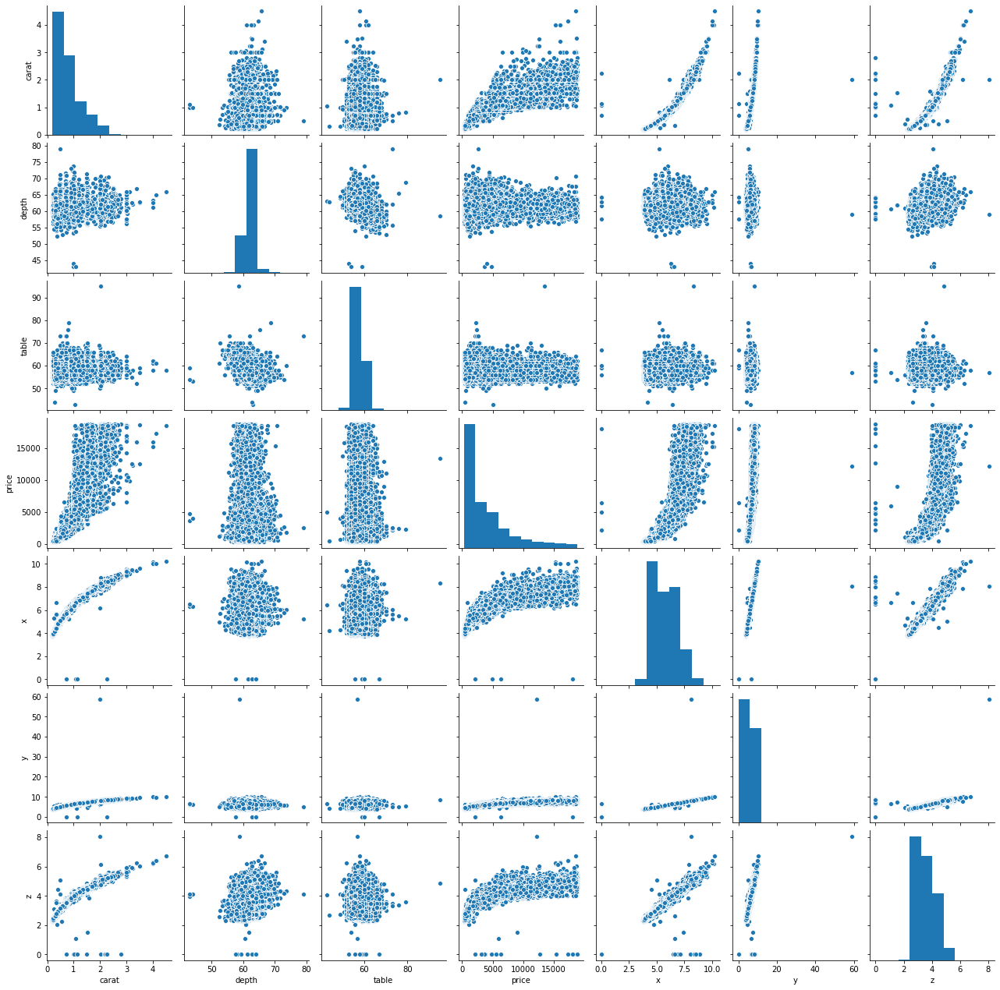

In [86]:
fig = plt.figure(figsize=(32, 16))
ax = sns.pairplot(diamonds)
plt.show()

### Distribution of **Carat**:

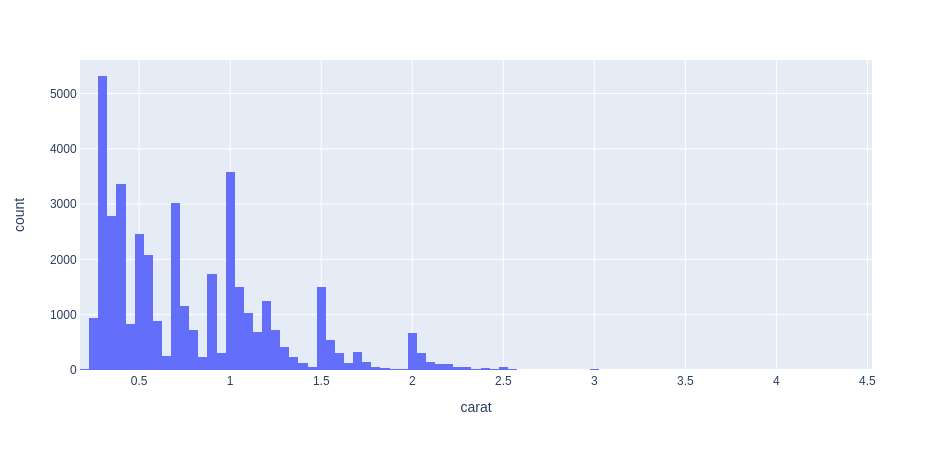

In [60]:
px.histogram(diamonds,x='carat', nbins=100)

#### We can observe that the carat has jumps (or groups) around some point values, it is not distributed in a normal way. 
#### The main points values (more than 1000*) are: 0.3 / 0.35 / 0.4 / 0.5 / 0.55 / 0.7 / 0.75 / 0.9 / 1.0 / 1.05 / 1.2 / 1.5 / 2 

### Price vs. Carat (different type of **'cut'**)

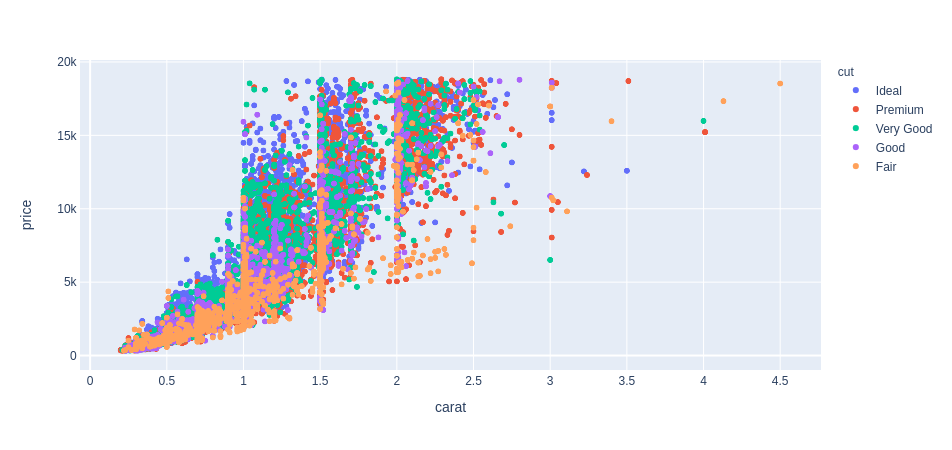

In [91]:
px.scatter(diamonds, 
           x='carat', 
           y='price', 
           color='cut',
           category_orders={"cut": ['Ideal', 'Premium', 'Very Good', 'Good' , 'Fair' ]})

#### We observed the groups that we saw before in the histogram of the "carat". We can see that many diamonds are grouped on those typical values. When filtering for example by the column "cut", we see how diamonds with a "cut" of better quality have a higher price than those of worse quality.
#### Although we also see how within each type of "cut" there is a different range of prices for a diamond with the same "carat", so **the diamond value does not only depend on the type of "cut" and the "carat"**.

### Price vs. Carat (different type of **'color'**)

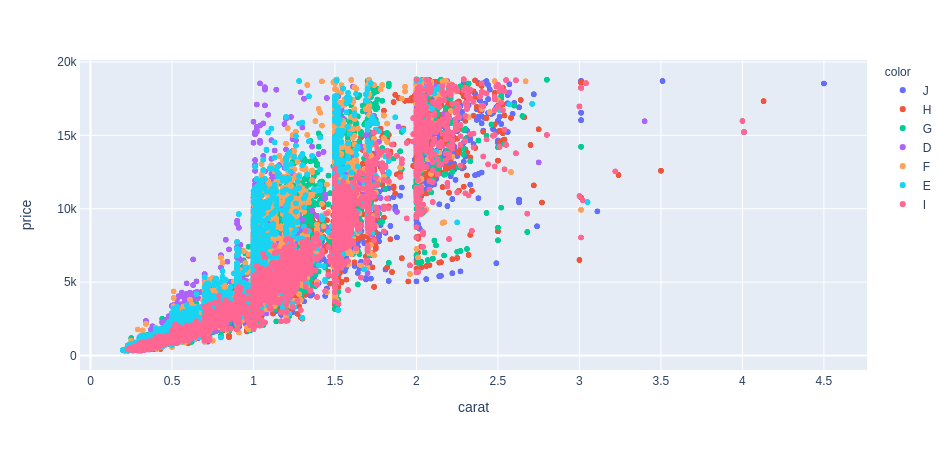

In [93]:
px.scatter(diamonds, 
           x='carat', 
           y='price', 
           color='color')

#### As we mentioned before, the price of a diamond with the same "carat" does not depend only on it but on the combination of various qualities such as "cut", "color", "clarity" and the **"shape"**

### Distribution of **Price**:

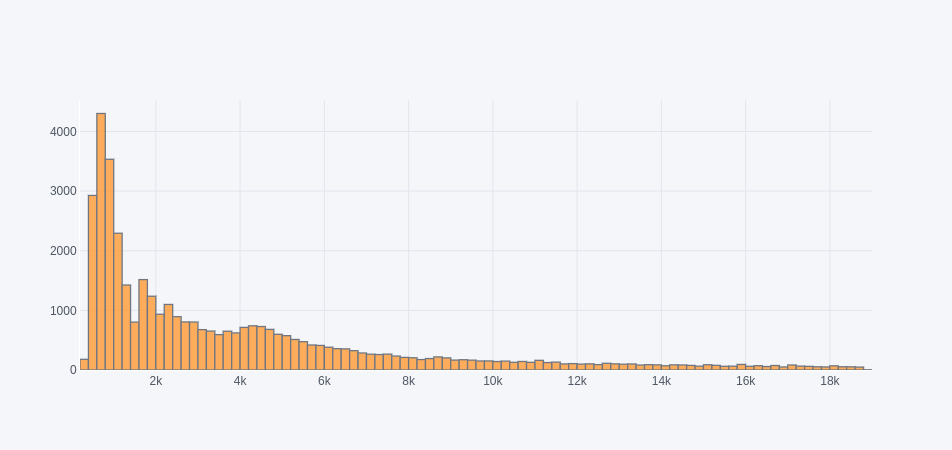

In [98]:
diamonds['price'].iplot(kind='histogram', bins=100)

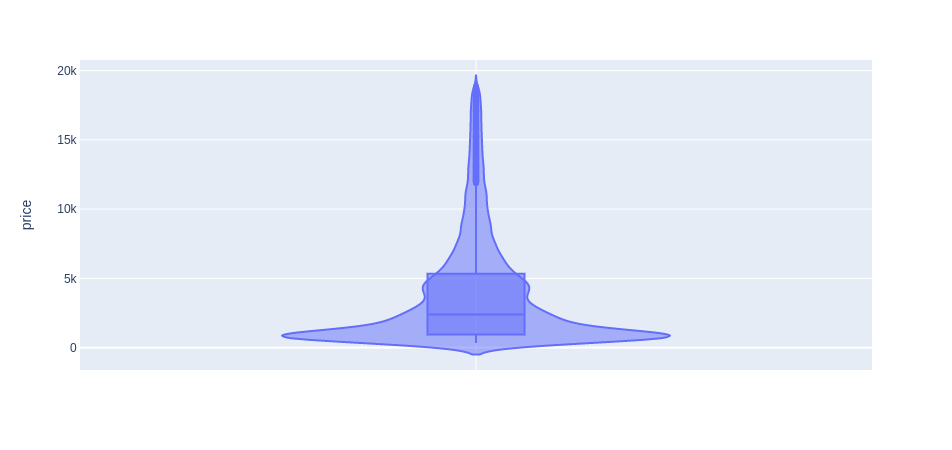

In [97]:
px.violin(diamonds, y='price', box=True)

#### We can see that most diamonds are priced between 950 and 5300, although the groups with the highest number of diamonds are between 400 and 1200.
#### This is because most of the diamonds that exist are small and therefore have a lower price since large diamonds are rarer to find on earth.

### Distribution of **Price** (different type of **'cut'**):

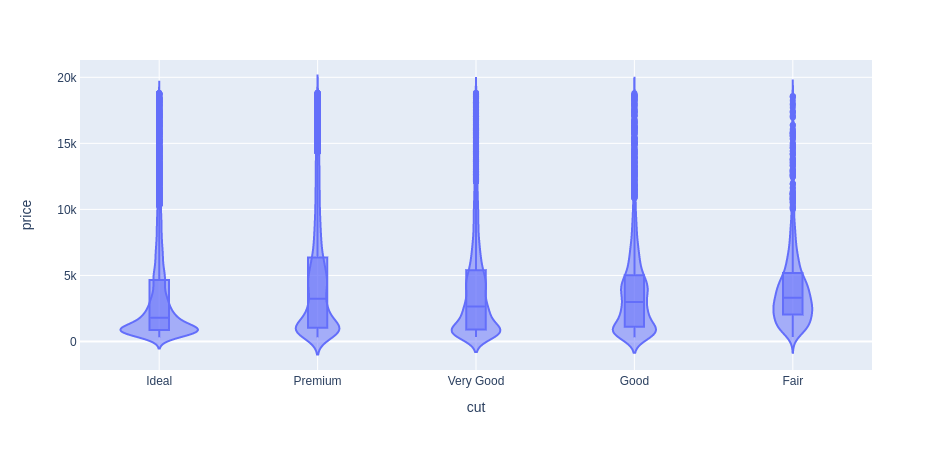

In [24]:
px.violin(diamonds, x='cut', y='price', box=True, category_orders={"cut": ['Ideal', 'Premium', 'Very Good', 'Good' , 'Fair' ]})

#### adad

In [51]:
diamonds.groupby(['cut'], as_index=False)['price'].mean()

,cut,price
0,Fair,4333.271980
1,Good,3880.611794
2,Ideal,3436.112577
3,Premium,4617.322612
4,Very Good,3994.444420


In [20]:
diamonds.groupby(['cut'], as_index=False)['price'].count()

,cut,price
0,Fair,1217
1,Good,3663
2,Ideal,16220
3,Premium,10260
4,Very Good,9095


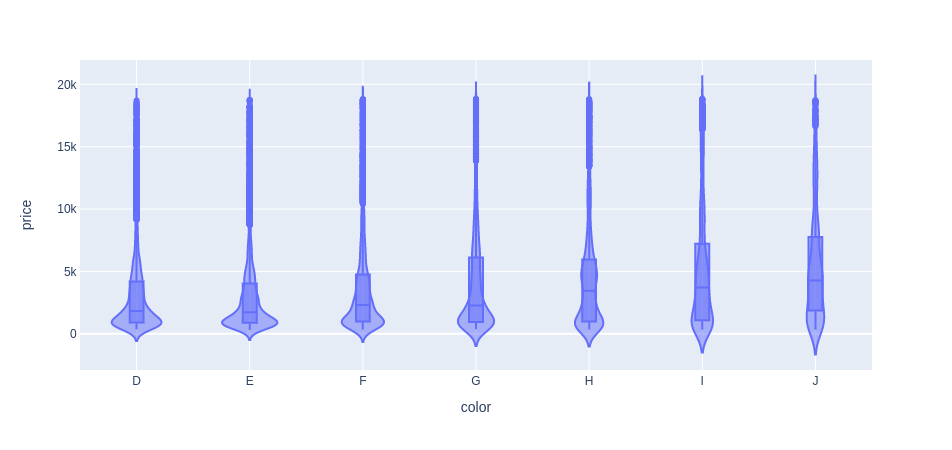

In [22]:
px.violin(diamonds, x='color', y='price', box=True, category_orders={"color": ['D','E', 'F','G', 'H', 'I', 'J']})

In [54]:
diamonds.groupby('color', as_index=False)['price'].mean()

,color,price
0,D,3134.943157
1,E,3088.342526
2,F,3677.355720
3,G,4023.214902
4,H,4476.469014
5,I,5090.868800
6,J,5346.234112


In [55]:
diamonds.groupby('color', as_index=False)['price'].count()

,color,price
0,D,5049
1,E,7325
2,F,7177
3,G,8455
4,H,6277
5,I,4032
6,J,2140


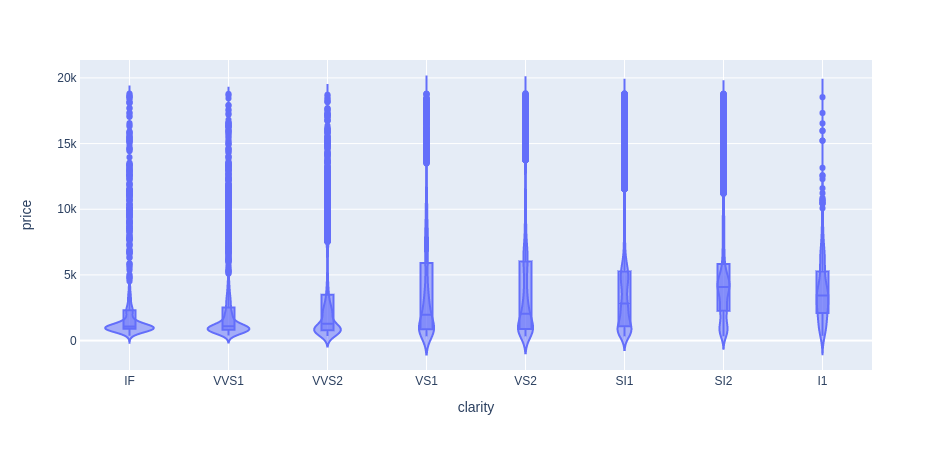

In [56]:
px.violin(diamonds, x='clarity', y='price', box=True, category_orders={"clarity": ['IF', 'VVS1', 'VVS2', 'VS1', 'VS2', 'SI1', 'SI2', 'I1']})

In [57]:
diamonds.groupby('clarity', as_index=False)['price'].mean()

,clarity,price
0,I1,3971.206039
1,IF,2797.897513
2,SI1,3999.856908
3,SI2,5101.044307
4,VS1,3796.813551
5,VS2,3913.590182
6,VVS1,2559.498558
7,VVS2,3240.978942


In [58]:
diamonds.groupby('clarity', as_index=False)['price'].count()

,clarity,price
0,I1,563
1,IF,1327
2,SI1,9749
3,SI2,6929
4,VS1,6066
5,VS2,9248
6,VVS1,2774
7,VVS2,3799


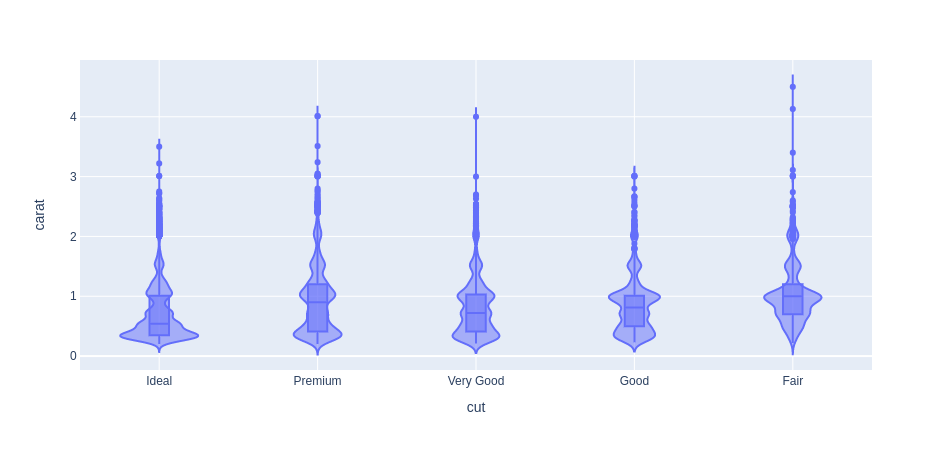

In [65]:
px.violin(diamonds, x='cut', y='carat', box=True, category_orders={"cut": ['Ideal', 'Premium', 'Very Good', 'Good' , 'Fair' ]})

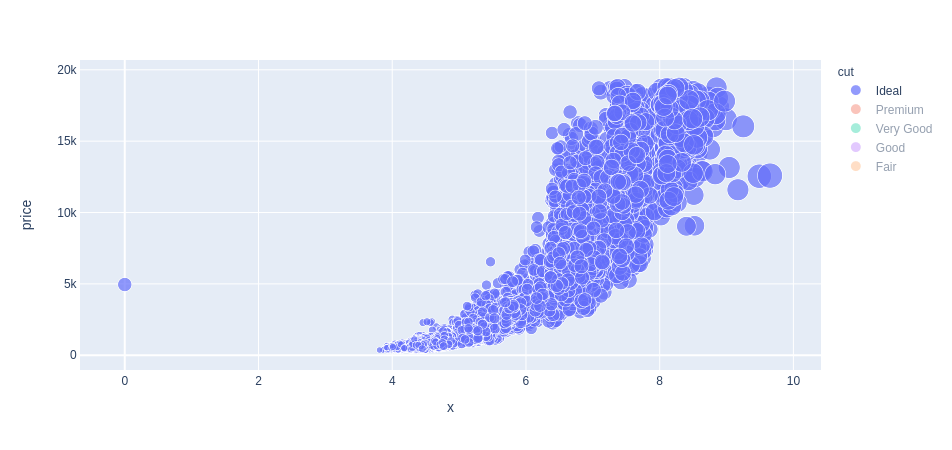

In [78]:
px.scatter(diamonds, x='x', y='price', color='cut', category_orders={"cut": ['Ideal', 'Premium', 'Very Good', 'Good' , 'Fair' ]},size='carat')

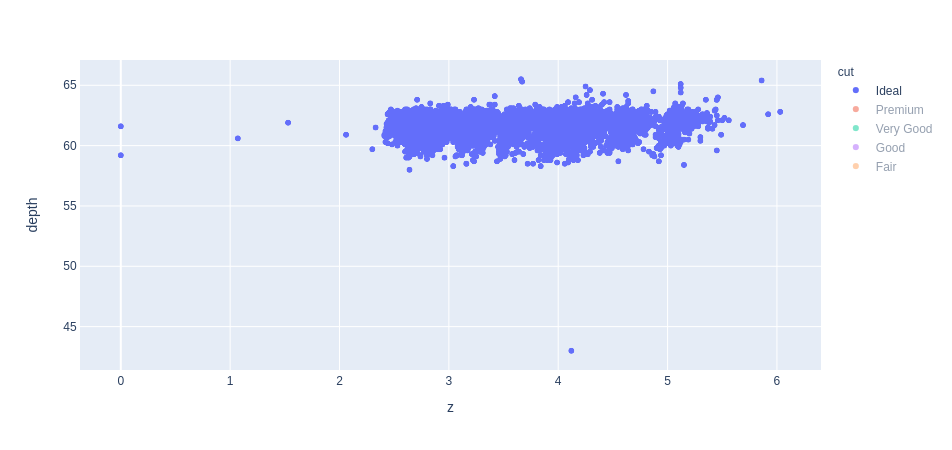

In [80]:
px.scatter(diamonds, x='z', y='depth', color='cut', category_orders={"cut": ['Ideal', 'Premium', 'Very Good', 'Good' , 'Fair' ]})

### Raw density of diamonds

In [64]:
diamonds['raw_density'] = (diamonds['carat']*0.2)/(diamonds['x']*diamonds['x']*diamonds['z']/3/1000)

diamonds.head()

,carat,cut,color,clarity,depth,table,price,x,y,z,raw_density
0,1.21,Premium,J,VS2,62.4,58.0,4268,6.83,6.79,4.25,3.661898
1,0.32,Very Good,H,VS2,63.0,57.0,505,4.35,4.38,2.75,3.689691
2,0.71,Fair,G,VS1,65.5,55.0,2686,5.62,5.53,3.65,3.695252
3,0.41,Good,D,SI1,63.8,56.0,738,4.68,4.72,3.00,3.743882
4,1.02,Ideal,G,SI1,60.5,59.0,4882,6.55,6.51,3.95,3.611368


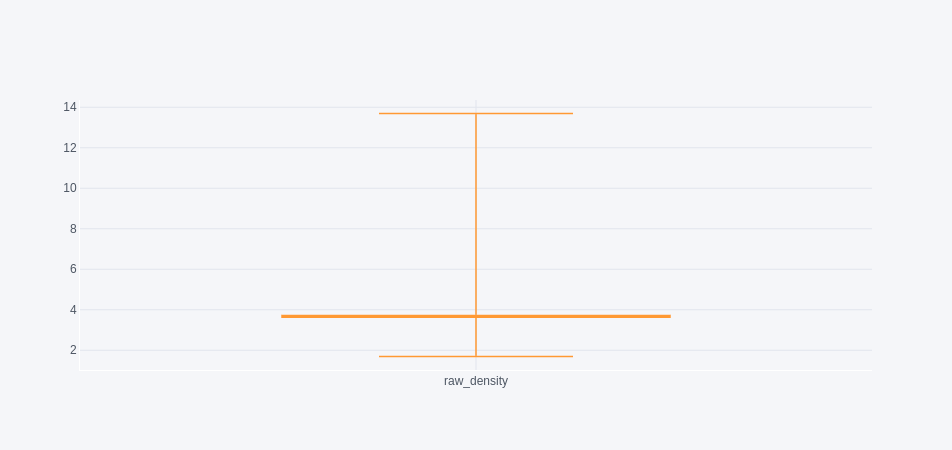

In [65]:
diamonds['raw_density'].iplot(kind='box')

#### The **density** of a diamond is 3.5 g/cm3 approximate. We can observe that we used the volumen of a pyramid with 4 equal sides (x²*z/3).
#### We can see in the box plot that most diamonds have a round shape but that there are some diamonds that have a different shape since their density is different from 3.5 approx.
#### If we see the quartiles that observe the limits of these differents diamonds: 3.72 - 3.63 , then the QR is 0.09 and we put the limits in 3.855 and 3.495, we have **905** diamonds outside these margins. These diamonds surely have a different shape from the common one (round diamond)


In [66]:
diamonds[(diamonds['raw_density']>3.855) | (diamonds['raw_density']<3.495)]

,carat,cut,color,clarity,depth,table,price,x,y,z,raw_density
6,1.01,Fair,H,VS2,65.2,56.0,3733,6.23,6.19,4.05,3.855152
11,1.02,Premium,I,SI1,58.0,58.0,4284,6.84,6.60,3.90,3.354089
150,1.01,Good,E,SI1,64.3,59.0,5379,6.23,6.28,4.02,3.883922
307,0.90,Good,I,VVS1,62.4,61.0,3972,6.05,6.09,3.79,3.892636
374,1.01,Fair,E,SI2,64.6,59.0,3294,6.22,6.18,4.01,3.906137
...,...,...,...,...,...,...,...,...,...,...,...
40239,1.00,Fair,G,SI1,67.7,57.0,3631,6.00,6.15,4.11,4.055150
40249,1.28,Good,G,SI2,63.6,57.0,4679,6.78,6.73,4.29,3.894436
40254,1.00,Good,H,VS2,63.6,61.0,4637,6.21,6.25,3.96,3.928917
40265,1.02,Fair,F,SI2,66.6,58.0,3633,6.21,6.14,4.11,3.861236


#### But we have **16 diamonds** with incorrect size (x, y, z) because these values has **"0"** in the DF

In [79]:
diamonds['x'][(diamonds['x']==0) | (diamonds['y']==0) |(diamonds['z']==0)].count()

16